In [3]:
import pandas as pd
import plotly.express as px

datapath = '../Data/Prepare&Load Data/Improved datasplit/'

### Load Data

In [4]:
training_data_2012 = pd.read_csv(datapath+'BPI_Challenge_2012-training.csv', parse_dates=['case:REG_DATE', 'time:timestamp']) 
training_data_2012 = training_data_2012.sort_values(by=["time:timestamp"])

Info on data: https://www.win.tue.nl/~hverbeek/downloads/preprints/Verbeek12c.pdf

In [5]:
training_data_2012

,Unnamed: 0,org:resource,lifecycle:transition,concept:name,time:timestamp,case:REG_DATE,case:concept:name,case:AMOUNT_REQ,time until next event,next event,activity number in case
0,0,112.0,COMPLETE,A_SUBMITTED,2011-09-30 22:38:44.546000+00:00,2011-09-30 22:38:44.546000+00:00,173688,20000,0.334,A_PARTLYSUBMITTED,0
1,1,112.0,COMPLETE,A_PARTLYSUBMITTED,2011-09-30 22:38:44.880000+00:00,2011-09-30 22:38:44.546000+00:00,173688,20000,53.026,A_PREACCEPTED,1
2,2,112.0,COMPLETE,A_PREACCEPTED,2011-09-30 22:39:37.906000+00:00,2011-09-30 22:38:44.546000+00:00,173688,20000,0.969,W_Completeren aanvraag,2
3,3,112.0,SCHEDULE,W_Completeren aanvraag,2011-09-30 22:39:38.875000+00:00,2011-09-30 22:38:44.546000+00:00,173688,20000,39427.562,W_Completeren aanvraag,3
4,26,112.0,COMPLETE,A_SUBMITTED,2011-10-01 06:08:58.256000+00:00,2011-10-01 06:08:58.256000+00:00,173691,5000,3.939,A_PARTLYSUBMITTED,0
...,...,...,...,...,...,...,...,...,...,...,...
180848,194362,10629.0,COMPLETE,A_REGISTERED,2012-02-06 15:28:15.269000+00:00,2012-01-24 07:55:22.424000+00:00,203468,7000,8.130,W_Valideren aanvraag,28
180849,194363,10629.0,COMPLETE,W_Valideren aanvraag,2012-02-06 15:28:23.399000+00:00,2012-01-24 07:55:22.424000+00:00,203468,7000,NaN,NaN,29
180850,218208,112.0,COMPLETE,A_SUBMITTED,2012-02-06 15:34:32.377000+00:00,2012-02-06 15:34:32.377000+00:00,206844,8500,0.137,A_PARTLYSUBMITTED,0
180851,218209,112.0,COMPLETE,A_PARTLYSUBMITTED,2012-02-06 15:34:32.514000+00:00,2012-02-06 15:34:32.377000+00:00,206844,8500,46.035,A_DECLINED,1


https://ckmanalytix.com/the-2012-bpic-challenge-process-mining-driven-optimization-of-a-consumer-loan-approvals-process/

### Plot cases over time

Note, the dates seem to get rounded to the day, not the hours/min/sec

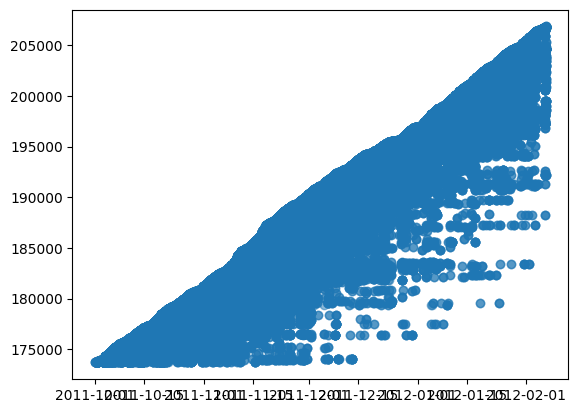

In [8]:
%matplotlib inline

import matplotlib
import numpy as np
import matplotlib.pyplot as plt
plt.scatter(training_data_2012["time:timestamp"], training_data_2012["case:concept:name"], alpha=0.5)
plt.show()

In [10]:
fig = px.scatter(training_data_2012, x="time:timestamp", y="case:concept:name", color="concept:name",
                 hover_data=['case:concept:name', 'time:timestamp', 'concept:name', 'case:AMOUNT_REQ'])
fig.show()

Not too sure how to interpret this full image as a whole. We do they only seem to work about once a month, and all events happen on these days. Is there a reason for this?

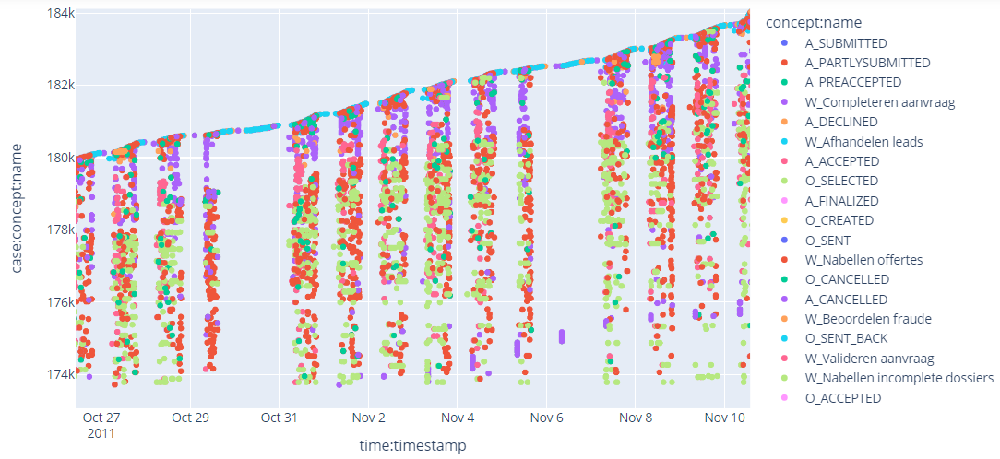

This is a zoomed in image of the plot above in an area with the more dense dots. It directly shows that almost no work is done on Sunday (18th december 2011 was a Sunday), (mostly people submitting). And that people work during working hours. Therefore this can be very predictive. 

### Plot 10 randomly selected cases

Note, you miss quite a lot. If you zoom in on the dots, there can be 8 dots in the place of one

In [12]:
import random

random.seed(1)
list_cases = training_data_2012['case:concept:name'].unique().tolist()
n = 10
selected_cases = random.sample(list_cases, n)
print(selected_cases)
filter_data_of_cases = training_data_2012[training_data_2012['case:concept:name'].isin(selected_cases)]

[180628, 204188, 176936, 186706, 179772, 199261, 196756, 197972, 193065, 184430]


In [13]:
fig = px.scatter(filter_data_of_cases, x="time:timestamp", y="case:concept:name", color="concept:name",
                 hover_data=['case:concept:name', 'time:timestamp', 'concept:name', 'case:AMOUNT_REQ'])
fig.show()

### Plot a single random case

In [15]:
list_cases = training_data_2012['case:concept:name'].unique().tolist()
n2 = 1
selected_cases2 = random.sample(list_cases, n2)
print(selected_cases2)
filter_data_of_cases2 = training_data_2012[training_data_2012['case:concept:name'].isin(selected_cases2)]

[178533]


In [16]:
fig = px.scatter(filter_data_of_cases2, x="time:timestamp", y="case:concept:name", color="concept:name",
                 hover_data=['case:concept:name', 'time:timestamp', 'concept:name', 'case:AMOUNT_REQ'])
fig.show()

By zooming in we can find that there are massive differences between the times between events. Could be milliseconds, or could be months.

### Understand which events there are

In [17]:
training_data_2012["concept:name"].unique()

array(['A_SUBMITTED', 'A_PARTLYSUBMITTED', 'A_PREACCEPTED',
       'W_Completeren aanvraag', 'A_DECLINED', 'W_Afhandelen leads',
       'A_ACCEPTED', 'O_SELECTED', 'A_FINALIZED', 'O_CREATED', 'O_SENT',
       'W_Nabellen offertes', 'O_CANCELLED', 'A_CANCELLED',
       'W_Beoordelen fraude', 'O_SENT_BACK', 'W_Valideren aanvraag',
       'W_Nabellen incomplete dossiers', 'O_ACCEPTED', 'A_ACTIVATED',
       'A_REGISTERED', 'A_APPROVED', 'O_DECLINED',
       'W_Wijzigen contractgegevens'], dtype=object)

There are also event transitions. We can make a column combining these

In [18]:
training_data_2012["lifecycle:transition"].unique()

array(['COMPLETE', 'SCHEDULE', 'START'], dtype=object)

In [19]:
# Create combined column of event_type and event_transition. E.g. A_Accepted-Complete
training_data_2012["event_type_and_status"] = training_data_2012["concept:name"] + '-' + training_data_2012["lifecycle:transition"]

In [20]:
def compute_all_combinations_of_events_and_occurrences(training_data_2012, column):
    # We want to iterate over each case
    all_cases = training_data_2012['case:concept:name'].unique().tolist()
    # Make list of all events that occur after each other. Later we can count in this list how often
    # each combination of events occurred
    histogram_event_combinations_base = {}
    for case in all_cases:
        case_data = training_data_2012[training_data_2012['case:concept:name'] == case]
        case_data.reset_index(inplace=True)
        number_of_rows = len(case_data.index)-1
        for i, row in case_data.iterrows():
            if i == 0:
                cons_event = ('start', row[column])
                if cons_event in histogram_event_combinations_base:
                    histogram_event_combinations_base[cons_event] += 1
                else:
                    histogram_event_combinations_base[cons_event] = 1
            elif i == number_of_rows:
                cons_event = (row[column], 'end')
                if cons_event in histogram_event_combinations_base:
                    histogram_event_combinations_base[cons_event] += 1
                else:
                    histogram_event_combinations_base[cons_event] = 1
            else: 
                current_event = row[column]
                previous_event = case_data.loc[i-1, column]
                cons_event = (previous_event, current_event)
                if cons_event in histogram_event_combinations_base:
                    histogram_event_combinations_base[cons_event] += 1
                else:
                    histogram_event_combinations_base[cons_event] = 1

    return histogram_event_combinations_base

In [21]:
histogram_event_combinations_base = compute_all_combinations_of_events_and_occurrences(training_data_2012, "concept:name") # event_type_and_status / event concept:name  
# Could also use column = "event_type_and_status", for events and status nodes

In [26]:
from pyvis.network import Network

def create_network(nodes, edges):
    g = Network(notebook=True, directed=True)
    for node in nodes:
        g.add_node(node, title=node)
    for edge in edges:
        g.add_edge(edge[0], edge[1], value=edges[edge], title=str(edges[edge]))
    return g.show('test.html')

In [28]:
from collections import Counter
most_common_edges=50  # 50 shows almost all nodes being connected

In [29]:
counter_dict = Counter(histogram_event_combinations_base)
print(f"Total possible combinations of events: {len(counter_dict)}")
most_relevant_edges = dict(counter_dict.most_common(most_common_edges))
most_relevant_edges

Total possible combinations of events: 118


{('W_Completeren aanvraag', 'W_Completeren aanvraag'): 24799,
 ('W_Nabellen offertes', 'W_Nabellen offertes'): 23954,
 ('W_Nabellen incomplete dossiers', 'W_Nabellen incomplete dossiers'): 12073,
 ('start', 'A_SUBMITTED'): 9777,
 ('A_SUBMITTED', 'A_PARTLYSUBMITTED'): 9777,
 ('W_Afhandelen leads', 'W_Afhandelen leads'): 5382,
 ('A_PREACCEPTED', 'W_Completeren aanvraag'): 5130,
 ('O_CREATED', 'O_SENT'): 4626,
 ('O_SENT', 'W_Nabellen offertes'): 4377,
 ('W_Valideren aanvraag', 'W_Valideren aanvraag'): 4058,
 ('W_Valideren aanvraag', 'W_Nabellen incomplete dossiers'): 3876,
 ('A_PARTLYSUBMITTED', 'W_Afhandelen leads'): 3662,
 ('W_Nabellen incomplete dossiers', 'W_Valideren aanvraag'): 3617,
 ('W_Completeren aanvraag', 'A_ACCEPTED'): 3449,
 ('W_Nabellen offertes', 'W_Completeren aanvraag'): 3375,
 ('W_Completeren aanvraag', 'W_Nabellen offertes'): 3375,
 ('A_PARTLYSUBMITTED', 'A_PREACCEPTED'): 3332,
 ('A_DECLINED', 'end'): 2728,
 ('O_SENT_BACK', 'W_Valideren aanvraag'): 2366,
 ('W_Valideren

In [30]:
nodes = training_data_2012["concept:name"].unique().tolist()
nodes.append('start')
nodes.append('end')
edges = most_relevant_edges
create_network(nodes, edges)

Local cdn resources have problems on chrome/safari when used in jupyter-notebook. 


### Other statistics

### NaN values per column

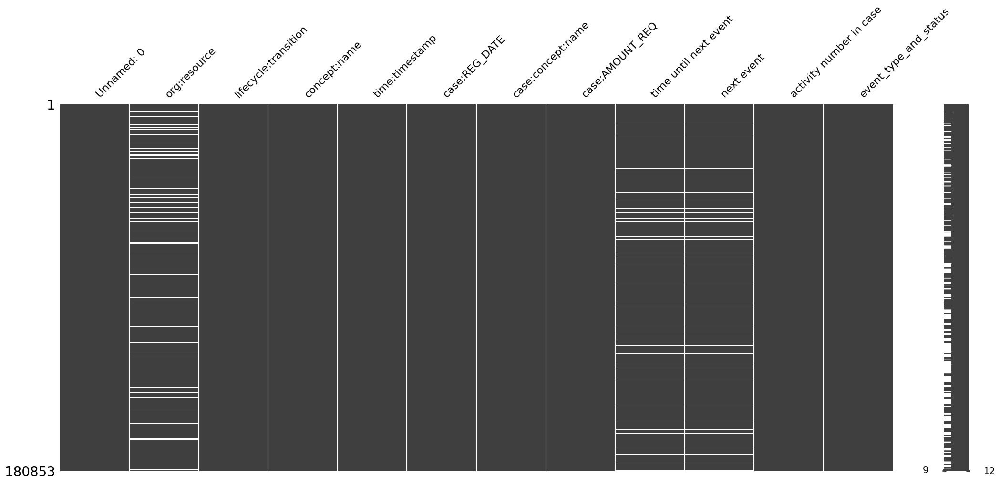

In [31]:
import missingno as msno
msno.matrix(training_data_2012);

In [32]:
percent_missing = training_data_2012.isnull().sum() * 100 / len(training_data_2012)
missing_value_df = pd.DataFrame({'column_name': training_data_2012.columns,
                                 'percent_missing': percent_missing})
missing_value_df.reset_index(inplace=True, drop=True)
missing_value_df

,column_name,percent_missing
0,Unnamed: 0,0.000000
1,org:resource,9.097997
2,lifecycle:transition,0.000000
3,concept:name,0.000000
4,time:timestamp,0.000000
5,case:REG_DATE,0.000000
6,case:concept:name,0.000000
7,case:AMOUNT_REQ,0.000000
8,time until next event,5.406048
9,next event,5.406048


### Avg number of events per case

In [34]:
def compute_avg_number_events_per_case(data):
    all_cases = data['concept:name'].unique().tolist()
    nr_cases = len(all_cases)
    total_nr_events = 0
    for case in all_cases:
        case_data = data[data['concept:name'] == case]
        number_events_of_case = len(case_data.index)
        total_nr_events += number_events_of_case
    avg_nr_events = total_nr_events / nr_cases
    return avg_nr_events

avg_nr_events = compute_avg_number_events_per_case(training_data_2012)

In [35]:
avg_nr_events

7535.541666666667

Also interesting to know quantiles, mode etc. So make dataframe with case numbers and nr cases.

### Avg time a case takes in total

In [38]:
from datetime import datetime, timedelta

def compute_case_relative_time(data):
    data['case_relative_time'] = 0.0
    all_cases = data['concept:name'].unique().tolist()
    for case in all_cases:
        case_data = data[data['concept:name'] == case]
        number_of_rows = len(case_data.index)-1
        first_case_counter = 0
        for i, row in case_data.iterrows():
            if first_case_counter < 1: # first event of case
                start_time = data.loc[i, 'time:timestamp']
                first_case_counter += 1
                # print(start_time)
                continue # Because the case_relative_time column was initialized with zeros
            else:
                current_time = data.loc[i, 'time:timestamp']
                # print(current_time)
                time_diff = current_time - start_time
                # print(time_diff)
                time_diff = time_diff.total_seconds()
                # print(time_diff)
                data.loc[i, 'case_relative_time'] = time_diff
    return data

In [39]:
a = compute_case_relative_time(training_data_2012)

In [40]:
a

,Unnamed: 0,org:resource,lifecycle:transition,concept:name,time:timestamp,case:REG_DATE,case:concept:name,case:AMOUNT_REQ,time until next event,next event,activity number in case,event_type_and_status,case_relative_time
0,0,112.0,COMPLETE,A_SUBMITTED,2011-09-30 22:38:44.546000+00:00,2011-09-30 22:38:44.546000+00:00,173688,20000,0.334,A_PARTLYSUBMITTED,0,A_SUBMITTED-COMPLETE,0.000000e+00
1,1,112.0,COMPLETE,A_PARTLYSUBMITTED,2011-09-30 22:38:44.880000+00:00,2011-09-30 22:38:44.546000+00:00,173688,20000,53.026,A_PREACCEPTED,1,A_PARTLYSUBMITTED-COMPLETE,0.000000e+00
2,2,112.0,COMPLETE,A_PREACCEPTED,2011-09-30 22:39:37.906000+00:00,2011-09-30 22:38:44.546000+00:00,173688,20000,0.969,W_Completeren aanvraag,2,A_PREACCEPTED-COMPLETE,0.000000e+00
3,3,112.0,SCHEDULE,W_Completeren aanvraag,2011-09-30 22:39:38.875000+00:00,2011-09-30 22:38:44.546000+00:00,173688,20000,39427.562,W_Completeren aanvraag,3,W_Completeren aanvraag-SCHEDULE,0.000000e+00
4,26,112.0,COMPLETE,A_SUBMITTED,2011-10-01 06:08:58.256000+00:00,2011-10-01 06:08:58.256000+00:00,173691,5000,3.939,A_PARTLYSUBMITTED,0,A_SUBMITTED-COMPLETE,2.701371e+04
...,...,...,...,...,...,...,...,...,...,...,...,...,...
180848,194362,10629.0,COMPLETE,A_REGISTERED,2012-02-06 15:28:15.269000+00:00,2012-01-24 07:55:22.424000+00:00,203468,7000,8.130,W_Valideren aanvraag,28,A_REGISTERED-COMPLETE,1.089609e+07
180849,194363,10629.0,COMPLETE,W_Valideren aanvraag,2012-02-06 15:28:23.399000+00:00,2012-01-24 07:55:22.424000+00:00,203468,7000,NaN,NaN,29,W_Valideren aanvraag-COMPLETE,1.090462e+07
180850,218208,112.0,COMPLETE,A_SUBMITTED,2012-02-06 15:34:32.377000+00:00,2012-02-06 15:34:32.377000+00:00,206844,8500,0.137,A_PARTLYSUBMITTED,0,A_SUBMITTED-COMPLETE,1.112015e+07
180851,218209,112.0,COMPLETE,A_PARTLYSUBMITTED,2012-02-06 15:34:32.514000+00:00,2012-02-06 15:34:32.377000+00:00,206844,8500,46.035,A_DECLINED,1,A_PARTLYSUBMITTED-COMPLETE,1.112015e+07


In [42]:
def compute_avg_case_duration(data_with_time_column):
    all_cases = data_with_time_column['concept:name'].unique().tolist()
    nr_cases = len(all_cases)
    total_duration = 0
    for case in all_cases:
        case_data = data_with_time_column[data_with_time_column['concept:name'] == case]
        case_duration = case_data.case_relative_time.tolist()[-1]
        total_duration += case_duration
    avg_duration = total_duration / nr_cases
    return avg_duration

avg_time = compute_avg_case_duration(a)

In [43]:
avg_time

10814249.573624998

In [44]:
intervals = (
    ('weeks', 604800),  # 60 * 60 * 24 * 7
    ('days', 86400),    # 60 * 60 * 24
    ('hours', 3600),    # 60 * 60
    ('minutes', 60),
    ('seconds', 1),
)

def display_time(seconds, granularity=5):
    result = []

    for name, count in intervals:
        value = seconds // count
        if value:
            seconds -= value * count
            if value == 1:
                name = name.rstrip('s')
            result.append("{} {}".format(value, name))
    return ', '.join(result[:granularity])

display_time(avg_time)

'17.0 weeks, 6.0 days, 3.0 hours, 57.0 minutes, 29.0 seconds'

Also interesting to know quantiles, mode etc. So make dataframe with case numbers and nr cases.

### Final remark:

The resources are not completely clear what they mean, but this can be very important and predictive. If the number indicate people, who might have a certain work pace

In [45]:
training_data_2012['org:resource'].unique()

array([  112., 10912.,    nan, 10862., 10939., 11019., 11111., 11000.,
       11203., 11119., 10971., 11180., 10889., 11001., 11120., 11202.,
       10913., 10188., 10809., 10779., 11201., 10863., 10629., 10880.,
       10982., 11049., 10859., 11200., 11169., 11179., 10899., 11122.,
       11121., 10909., 10228., 11009., 11189., 10609., 10881., 11181.,
       11029., 10789., 11339., 10972., 11002., 10138., 10933., 10861.,
       10914., 11259., 11254., 10910., 10931., 10932., 10929., 11269.,
       10125., 11079., 11003., 10935., 10821., 10124., 11289., 11304.])